In [3]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def analyze_and_plot_phases(
    df, continuous_col, discrete_col, corr_col,
    coil_length_col, ramp_col="Master Ramp", correlation_threshold=0.7
):
    coil_length_values = df[coil_length_col]

    # if ramp singnal is always low like below 15 then it indicates an invalid or uninteresting run
    if df[ramp_col].max() <= 15:
        print("Low Master Ramp")
        return

    #identified the most common value of the ramp (plateu region or stable region)
    norm_val = df[ramp_col].mode()[0]
    # it contains the only rows where ramp value equals that mode value
    norm_df = df[df[ramp_col] == norm_val]

    # it is the start and end index of the plateu
    phase1_end = norm_df.index[0]
    phase2_end = norm_df.index[-1]

    # phase1_df -> before plateu
    # phase2_df -> plateu itself
    # phase3_df -> after plateu
    phase1_df = df.iloc[:phase1_end + 1]
    phase2_df = df.iloc[phase1_end:phase2_end + 1]
    phase3_df = df.iloc[phase2_end + 1:]

    window_size = 250

    def get_correlation_stats(data):
        # Extracts the correlation values from corr_col, skipping the first window_size - 1 rows and removing any NaN values.
        corr_series = data[corr_col].iloc[window_size - 1:].dropna()
        
        # counts the total number of valid correlation values
        total = len(corr_series)
        
        # Counts how many correlation values have an absolute value ≥ correlation_threshold (default: 0.7).
        significant = (corr_series.abs() >= correlation_threshold).sum()

        # return the tuple of total and significant
        return total, significant

    
    # --- Phase-wise Stats ---
    # Calculates correlation statistics for each phase using the get_correlation_stats function.
    phase1_total, phase1_significant = get_correlation_stats(phase1_df)
    phase2_total, phase2_significant = get_correlation_stats(phase2_df)
    phase3_total, phase3_significant = get_correlation_stats(phase3_df)

    print(f"Phase 1: Total Windows = {phase1_total}, Significant = {phase1_significant}")
    print(f"Phase 2: Total Windows = {phase2_total}, Significant = {phase2_significant}")
    print(f"Phase 3: Total Windows = {phase3_total}, Significant = {phase3_significant}")

    # --- Phase 2 Segmentation (into 5 parts) ---
    seg_size = len(phase2_df) // 5
    phase2_segments = []
    segment_stats = []
    segment_indices = []

    for i in range(5):
        start = i * seg_size
        end = (i + 1) * seg_size if i < 4 else len(phase2_df)
        # print(end, len(phase2_df))
        segment = phase2_df.iloc[start:end]
        phase2_segments.append(segment)

        total, significant = get_correlation_stats(segment)
        segment_stats.append((total, significant))
        global_index = phase2_df.index[start]
        # print(global_index)
        segment_indices.append(global_index)

        print(f"  Segment {i+1}: Total Windows = {total}, Significant = {significant}")

    # --- Plotting ---
    fig = make_subplots(
        rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.07,
        subplot_titles=[
            f"{continuous_col} Signal",
            f"{discrete_col} Signal",
            f"{corr_col}",
            f"{ramp_col} Signal"
        ]
    )

    # Signals
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[continuous_col], mode="lines", name=continuous_col,
                             line=dict(color="magenta")), row=1, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[discrete_col], mode="markers", name=discrete_col,
                             marker=dict(color="green", size=6)), row=2, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[corr_col], mode="lines", name="Rolling Correlation",
                             line=dict(color="purple")), row=3, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[ramp_col], mode="lines", name=ramp_col,
                             line=dict(color="black")), row=4, col=1)

    fig.add_hline(y=0, line=dict(color="red", dash="dash"), row=3, col=1)

    # Vertical lines for Phase boundaries
    x1 = df[coil_length_col].iloc[phase1_end]
    x2 = df[coil_length_col].iloc[phase2_end]
    for row in [1, 2, 3, 4]:
        fig.add_vline(x=x1, line=dict(color="blue", dash="dot"), row=row, col=1)
        fig.add_vline(x=x2, line=dict(color="blue", dash="dot"), row=row, col=1)

    # Vertical lines for segment boundaries
    for i, seg_idx in enumerate(segment_indices[1:], start=2):  # skip the first since it's phase1_end
        x = df[coil_length_col].iloc[seg_idx]
        for row in [1, 2, 3, 4]:
            fig.add_vline(x=x, line=dict(color="green", dash="dash"),
                          row=row, col=1,
                          annotation_text=f"Seg {i}", annotation_position="top right")

    fig.update_yaxes(title_text="IBA Signal", row=1, col=1)
    fig.update_yaxes(title_text="Shape Signal", dtick=1, row=2, col=1)
    fig.update_yaxes(title_text="Correlation", range=[-1, 1], dtick=0.2, row=3, col=1)
    fig.update_yaxes(title_text="Master Ramp", row=4, col=1)

    fig.update_xaxes(tickformat=",.0f", row=4, col=1)
    fig.update_layout(
        title_text=f"Analysis of {continuous_col} and {discrete_col}",
        height=1000,
        xaxis4=dict(title=coil_length_col),
        template="plotly_white",
        showlegend=True
    )

    fig.show()
# Example usage
df = pd.read_csv(r"D:\Stelco\5393522.csv")
analyze_and_plot_phases(
    df,
    continuous_col="Stand 4 OS Total Bending Feedback",
    discrete_col="Operator_Q_VW",
    corr_col="Stand 4 OS Total Bending Feedback_Rolling_Corr_Operator_Q_VW",
    coil_length_col="Coil Length [30ms]",
    ramp_col="Master Ramp"
)

KeyError: 'Stand 4 DS Total Bending Feedback_Rolling_Corr_Operator_Q_VW'


--- Coil ID: 5368982 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 1503, Significant = 100
Phase 3: Total Windows = 81, Significant = 0
  Segment 1: Total Windows = 300, Significant = 0
  Segment 2: Total Windows = 300, Significant = 41
  Segment 3: Total Windows = 300, Significant = 0
  Segment 4: Total Windows = 300, Significant = 59
  Segment 5: Total Windows = 303, Significant = 0


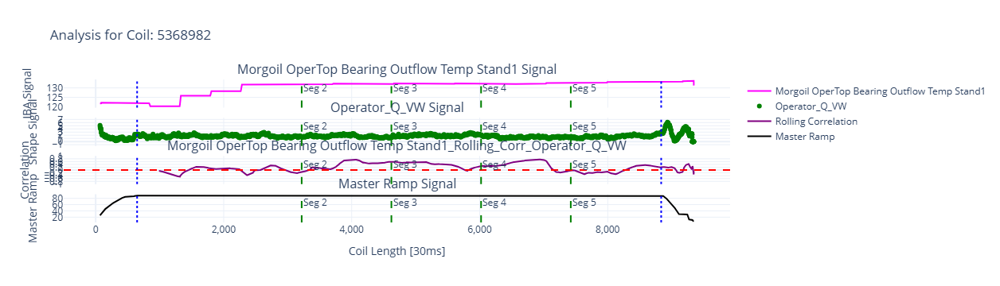


--- Coil ID: 5373379 ---
Phase 1: Total Windows = 547, Significant = 0
Phase 2: Total Windows = 9458, Significant = 622
Phase 3: Total Windows = 906, Significant = 0
  Segment 1: Total Windows = 1891, Significant = 110
  Segment 2: Total Windows = 1891, Significant = 72
  Segment 3: Total Windows = 1891, Significant = 0
  Segment 4: Total Windows = 1891, Significant = 261
  Segment 5: Total Windows = 1894, Significant = 179


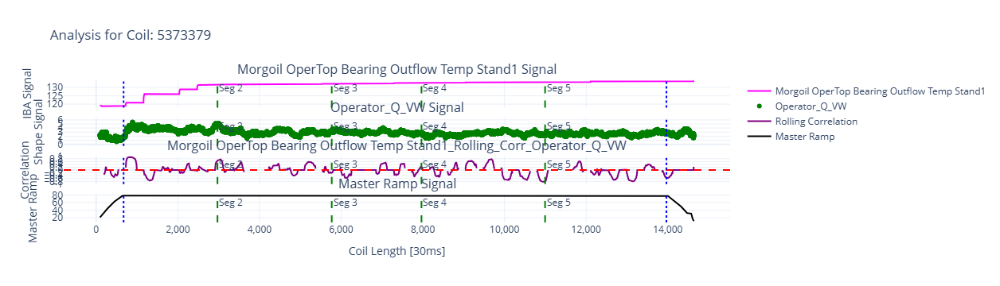


--- Coil ID: 5374891 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 3737, Significant = 308
Phase 3: Total Windows = 51, Significant = 0
  Segment 1: Total Windows = 747, Significant = 136
  Segment 2: Total Windows = 747, Significant = 117
  Segment 3: Total Windows = 747, Significant = 22
  Segment 4: Total Windows = 747, Significant = 0
  Segment 5: Total Windows = 749, Significant = 33


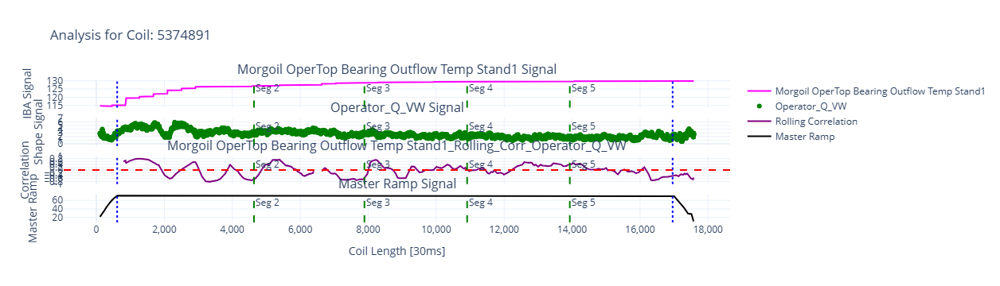


--- Coil ID: 5375729 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 3383, Significant = 247
Phase 3: Total Windows = 39, Significant = 0
  Segment 1: Total Windows = 676, Significant = 222
  Segment 2: Total Windows = 676, Significant = 0
  Segment 3: Total Windows = 676, Significant = 25
  Segment 4: Total Windows = 676, Significant = 0
  Segment 5: Total Windows = 679, Significant = 0


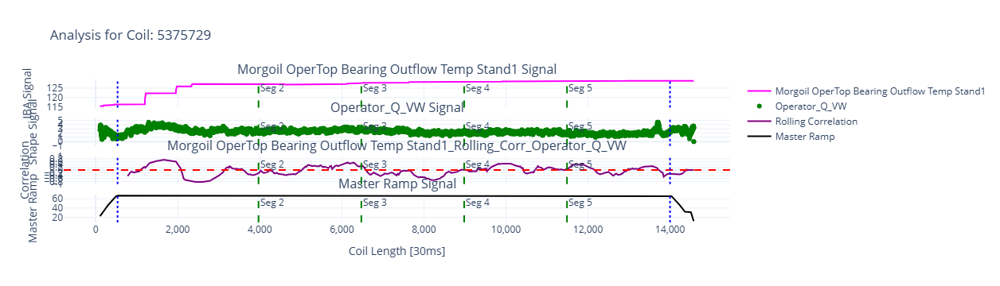


--- Coil ID: 5375779 ---
Phase 1: Total Windows = 177, Significant = 1
Phase 2: Total Windows = 1495, Significant = 110
Phase 3: Total Windows = 6, Significant = 0
  Segment 1: Total Windows = 299, Significant = 0
  Segment 2: Total Windows = 299, Significant = 0
  Segment 3: Total Windows = 299, Significant = 110
  Segment 4: Total Windows = 299, Significant = 0
  Segment 5: Total Windows = 299, Significant = 0


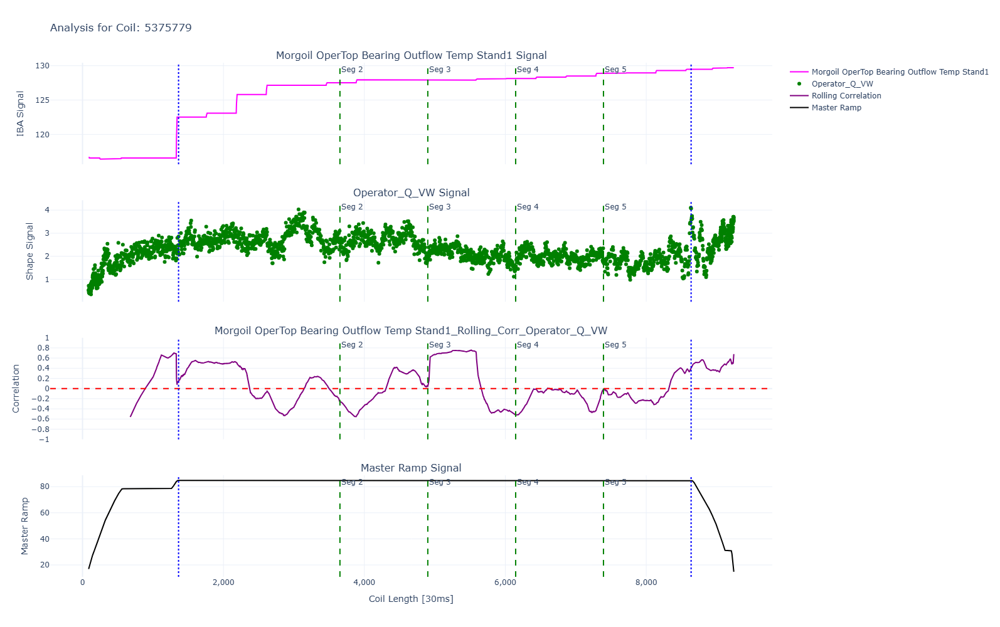


--- Coil ID: 5379971 ---
Phase 1: Total Windows = 187, Significant = 87
Phase 2: Total Windows = 1928, Significant = 107
Phase 3: Total Windows = 115, Significant = 22
  Segment 1: Total Windows = 385, Significant = 0
  Segment 2: Total Windows = 385, Significant = 0
  Segment 3: Total Windows = 385, Significant = 107
  Segment 4: Total Windows = 385, Significant = 0
  Segment 5: Total Windows = 388, Significant = 0


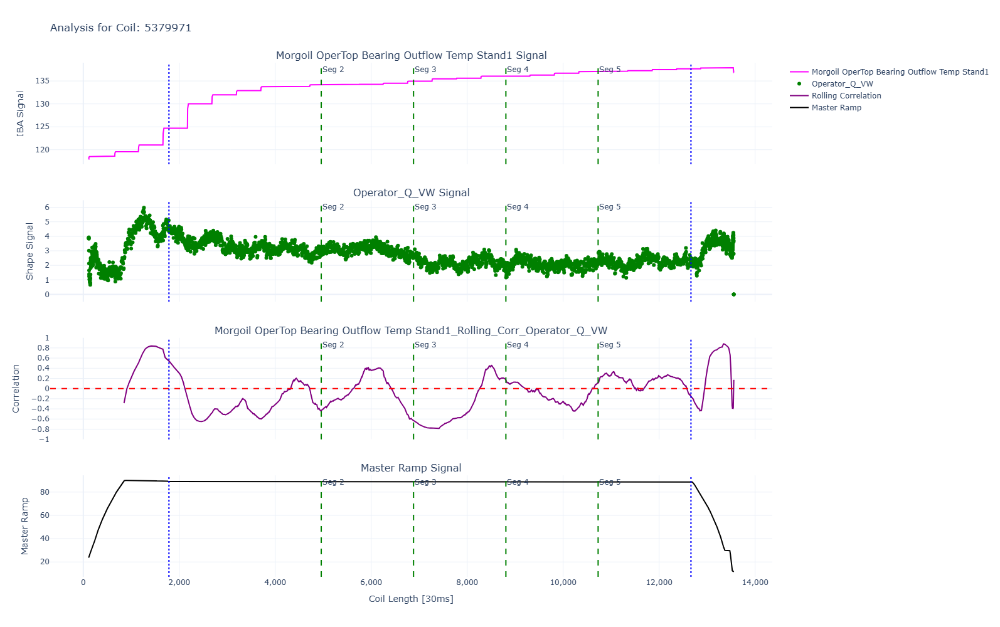


--- Coil ID: 5387141 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 3506, Significant = 203
Phase 3: Total Windows = 62, Significant = 0
  Segment 1: Total Windows = 701, Significant = 203
  Segment 2: Total Windows = 701, Significant = 0
  Segment 3: Total Windows = 701, Significant = 0
  Segment 4: Total Windows = 701, Significant = 0
  Segment 5: Total Windows = 702, Significant = 0


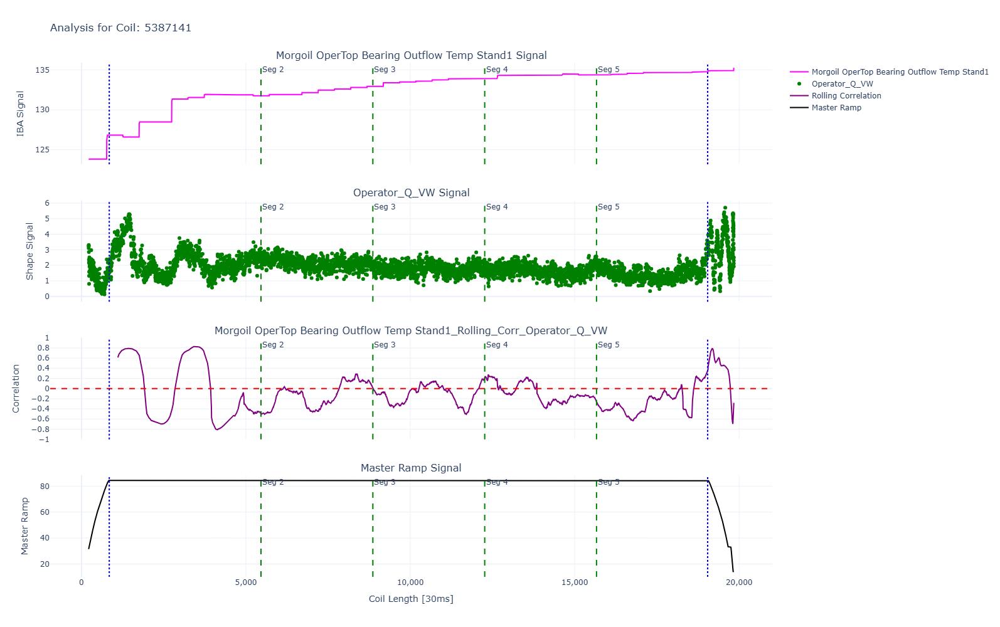


--- Coil ID: 5388660 ---
Phase 1: Total Windows = 29, Significant = 0
Phase 2: Total Windows = 1678, Significant = 118
Phase 3: Total Windows = 97, Significant = 0
  Segment 1: Total Windows = 335, Significant = 0
  Segment 2: Total Windows = 335, Significant = 60
  Segment 3: Total Windows = 335, Significant = 0
  Segment 4: Total Windows = 335, Significant = 58
  Segment 5: Total Windows = 338, Significant = 0


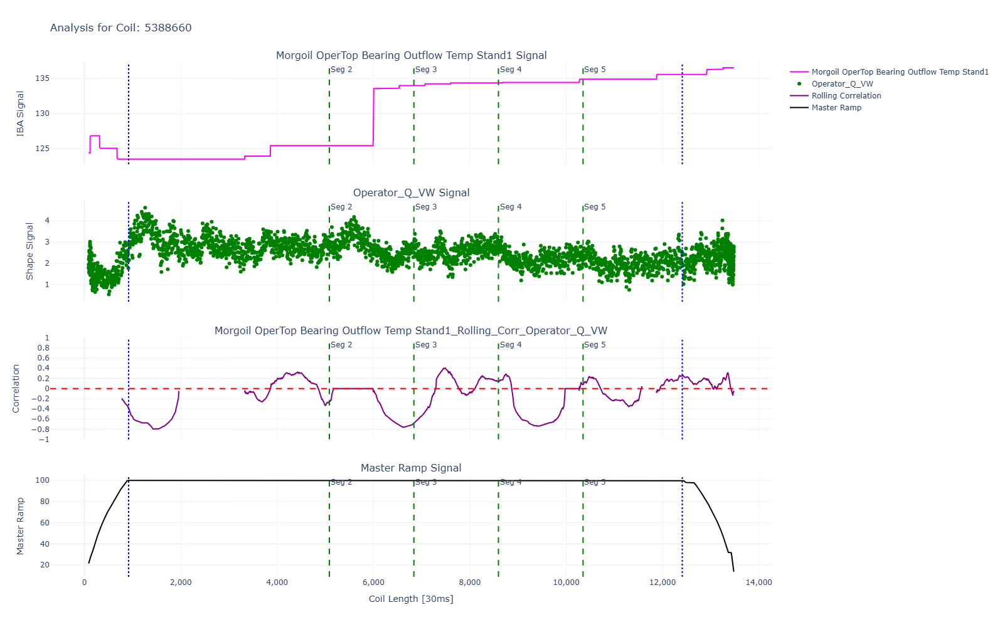


--- Coil ID: 5394913 ---
Phase 1: Total Windows = 243, Significant = 0
Phase 2: Total Windows = 4353, Significant = 284
Phase 3: Total Windows = 660, Significant = 0
  Segment 1: Total Windows = 870, Significant = 143
  Segment 2: Total Windows = 870, Significant = 141
  Segment 3: Total Windows = 870, Significant = 0
  Segment 4: Total Windows = 870, Significant = 0
  Segment 5: Total Windows = 873, Significant = 0


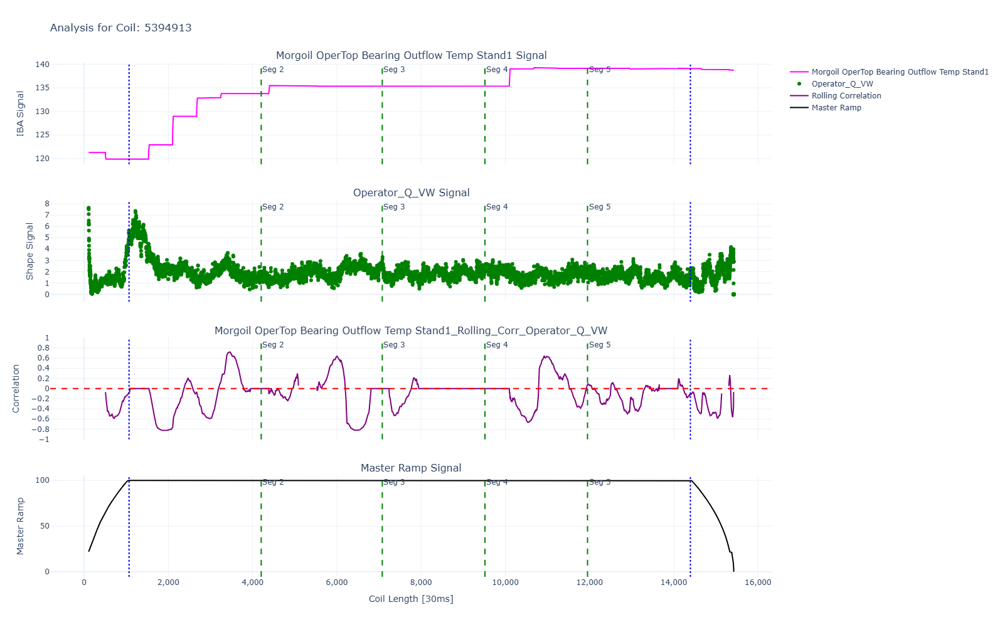


--- Coil ID: 5395007 ---
Phase 1: Total Windows = 48, Significant = 0
Phase 2: Total Windows = 1213, Significant = 106
Phase 3: Total Windows = 182, Significant = 0
  Segment 1: Total Windows = 242, Significant = 11
  Segment 2: Total Windows = 242, Significant = 95
  Segment 3: Total Windows = 242, Significant = 0
  Segment 4: Total Windows = 242, Significant = 0
  Segment 5: Total Windows = 245, Significant = 0


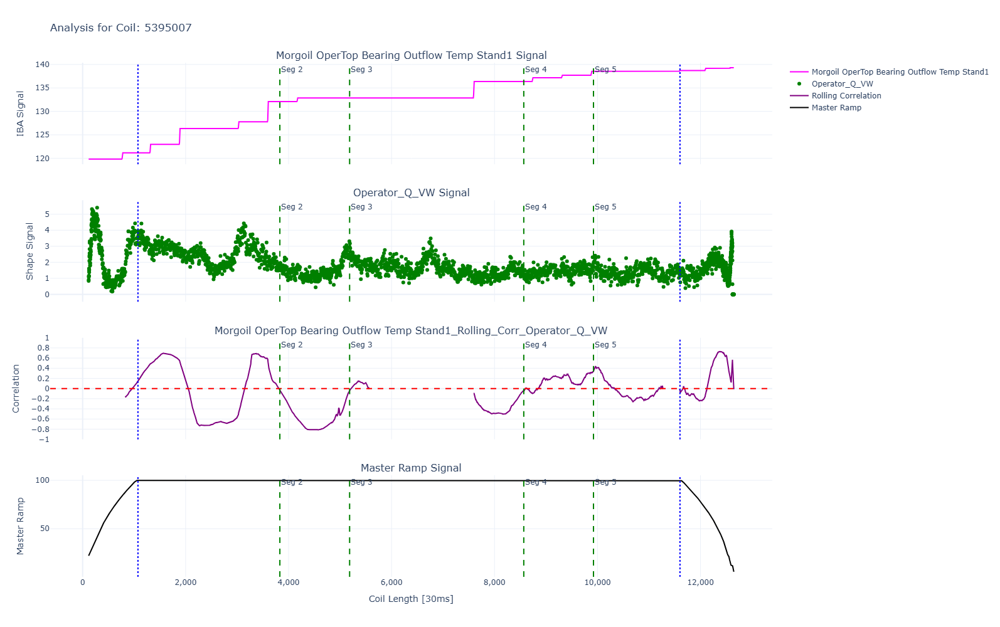


--- Coil ID: 5400313 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 3491, Significant = 243
Phase 3: Total Windows = 75, Significant = 0
  Segment 1: Total Windows = 698, Significant = 191
  Segment 2: Total Windows = 698, Significant = 0
  Segment 3: Total Windows = 698, Significant = 52
  Segment 4: Total Windows = 698, Significant = 0
  Segment 5: Total Windows = 699, Significant = 0


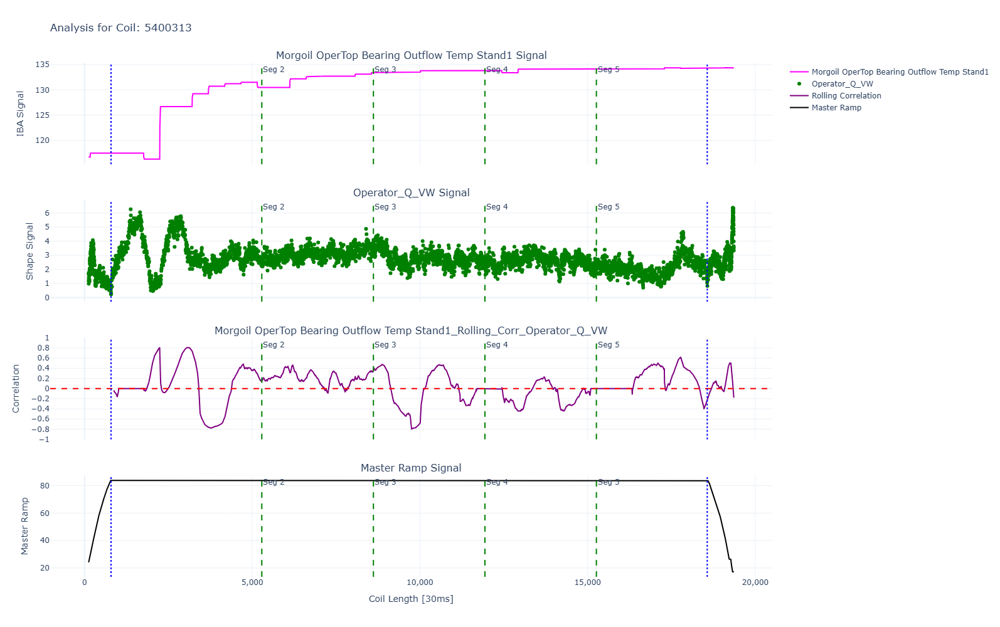


--- Coil ID: 5402682 ---
Phase 1: Total Windows = 275, Significant = 7
Phase 2: Total Windows = 1719, Significant = 234
Phase 3: Total Windows = 557, Significant = 0
  Segment 1: Total Windows = 343, Significant = 26
  Segment 2: Total Windows = 343, Significant = 87
  Segment 3: Total Windows = 343, Significant = 54
  Segment 4: Total Windows = 343, Significant = 67
  Segment 5: Total Windows = 347, Significant = 0


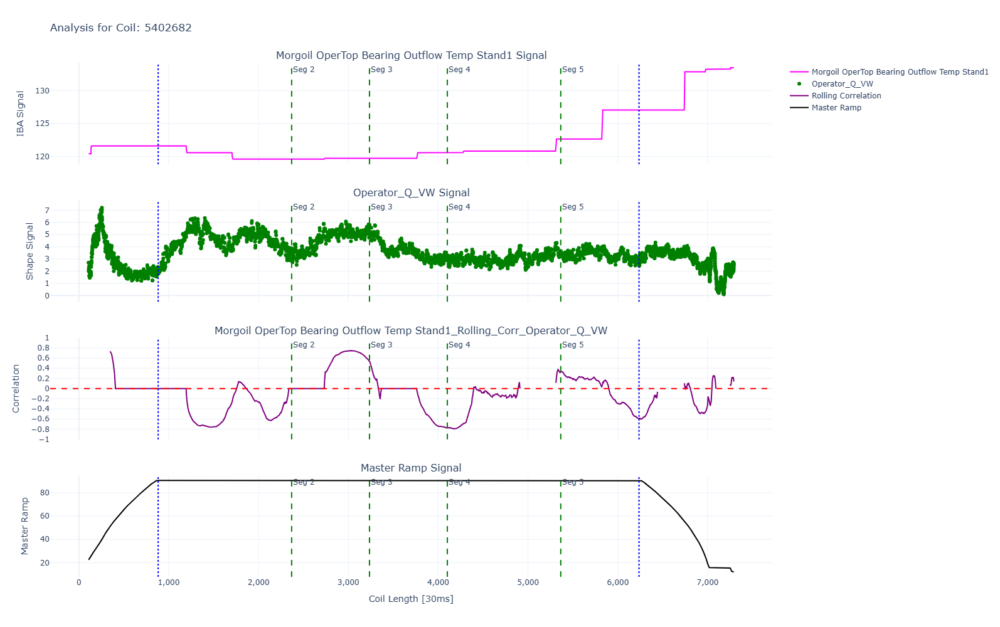


--- Coil ID: 5402876 ---
Phase 1: Total Windows = 20, Significant = 0
Phase 2: Total Windows = 2381, Significant = 254
Phase 3: Total Windows = 250, Significant = 46
  Segment 1: Total Windows = 476, Significant = 185
  Segment 2: Total Windows = 476, Significant = 44
  Segment 3: Total Windows = 476, Significant = 25
  Segment 4: Total Windows = 476, Significant = 0
  Segment 5: Total Windows = 477, Significant = 0


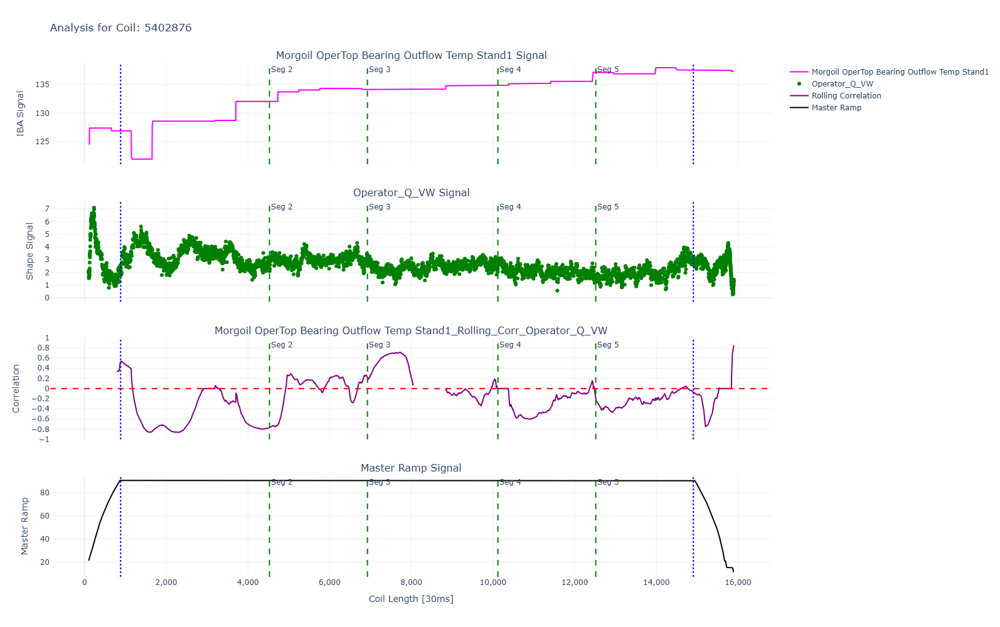


--- Coil ID: 5402883 ---
Phase 1: Total Windows = 317, Significant = 0
Phase 2: Total Windows = 2139, Significant = 155
Phase 3: Total Windows = 564, Significant = 0
  Segment 1: Total Windows = 427, Significant = 155
  Segment 2: Total Windows = 427, Significant = 0
  Segment 3: Total Windows = 427, Significant = 0
  Segment 4: Total Windows = 427, Significant = 0
  Segment 5: Total Windows = 431, Significant = 0


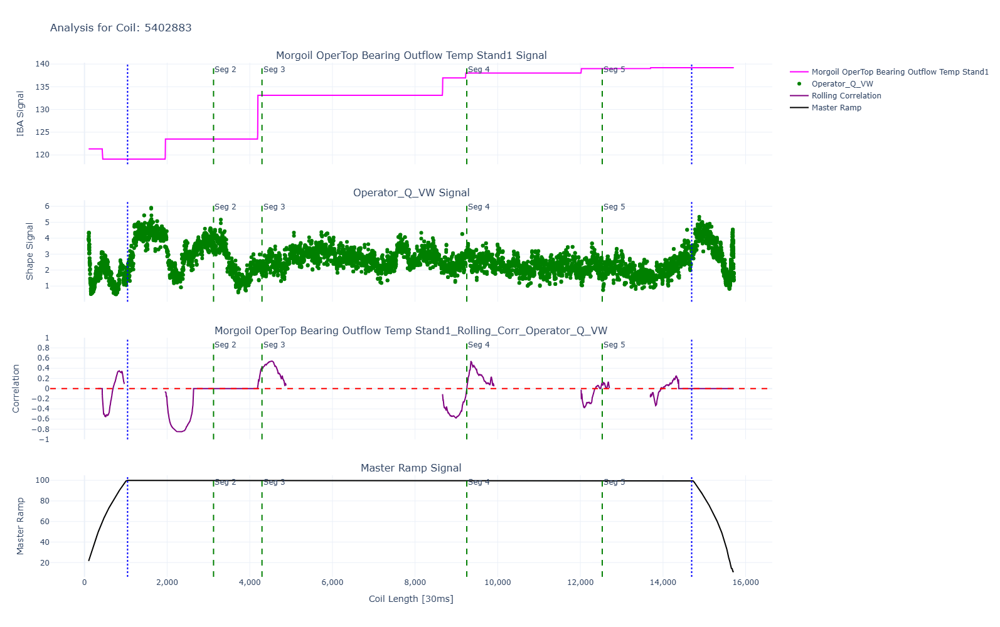


--- Coil ID: 5402965 ---
Phase 1: Total Windows = 16, Significant = 0
Phase 2: Total Windows = 2188, Significant = 268
Phase 3: Total Windows = 309, Significant = 0
  Segment 1: Total Windows = 437, Significant = 19
  Segment 2: Total Windows = 437, Significant = 142
  Segment 3: Total Windows = 437, Significant = 0
  Segment 4: Total Windows = 437, Significant = 107
  Segment 5: Total Windows = 440, Significant = 0


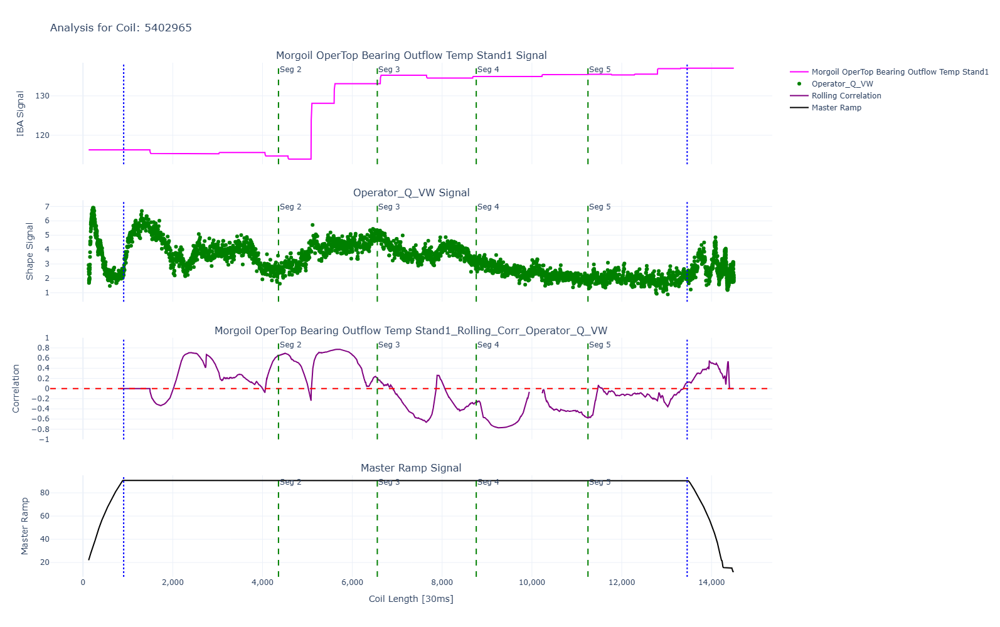


--- Coil ID: 5403626 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 1795, Significant = 92
Phase 3: Total Windows = 121, Significant = 36
  Segment 1: Total Windows = 359, Significant = 52
  Segment 2: Total Windows = 359, Significant = 40
  Segment 3: Total Windows = 359, Significant = 0
  Segment 4: Total Windows = 359, Significant = 0
  Segment 5: Total Windows = 359, Significant = 0


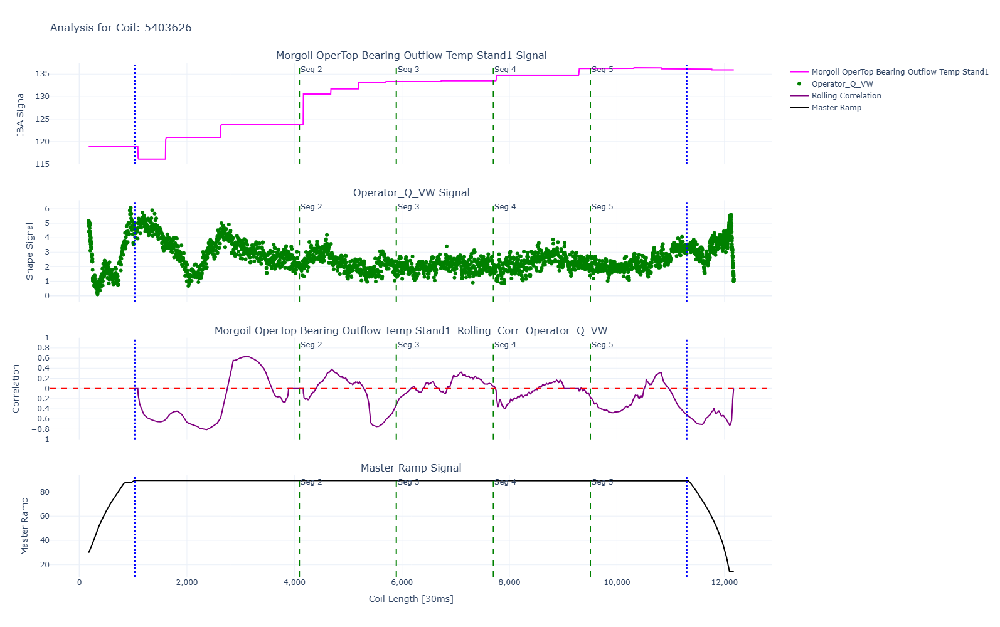


--- Coil ID: 5403991 ---
Phase 1: Total Windows = 23, Significant = 0
Phase 2: Total Windows = 2672, Significant = 139
Phase 3: Total Windows = 63, Significant = 0
  Segment 1: Total Windows = 534, Significant = 139
  Segment 2: Total Windows = 534, Significant = 0
  Segment 3: Total Windows = 534, Significant = 0
  Segment 4: Total Windows = 534, Significant = 0
  Segment 5: Total Windows = 536, Significant = 0


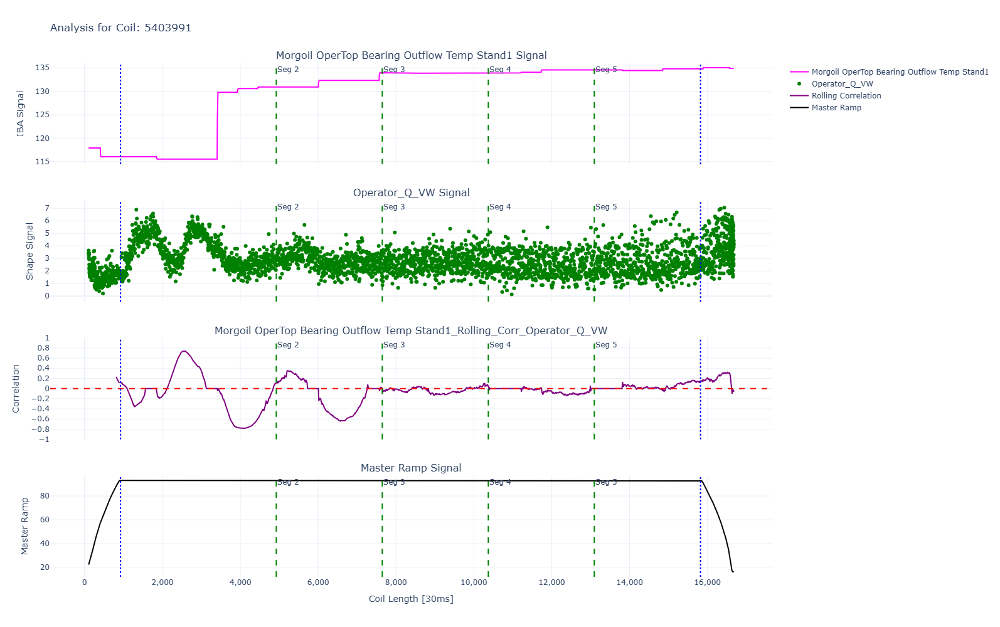


--- Coil ID: 5404527 ---
Phase 1: Total Windows = 1853, Significant = 7
Phase 2: Total Windows = 89, Significant = 42
Phase 3: Total Windows = 95, Significant = 0
  Segment 1: Total Windows = 17, Significant = 11
  Segment 2: Total Windows = 17, Significant = 17
  Segment 3: Total Windows = 17, Significant = 14
  Segment 4: Total Windows = 17, Significant = 0
  Segment 5: Total Windows = 21, Significant = 0


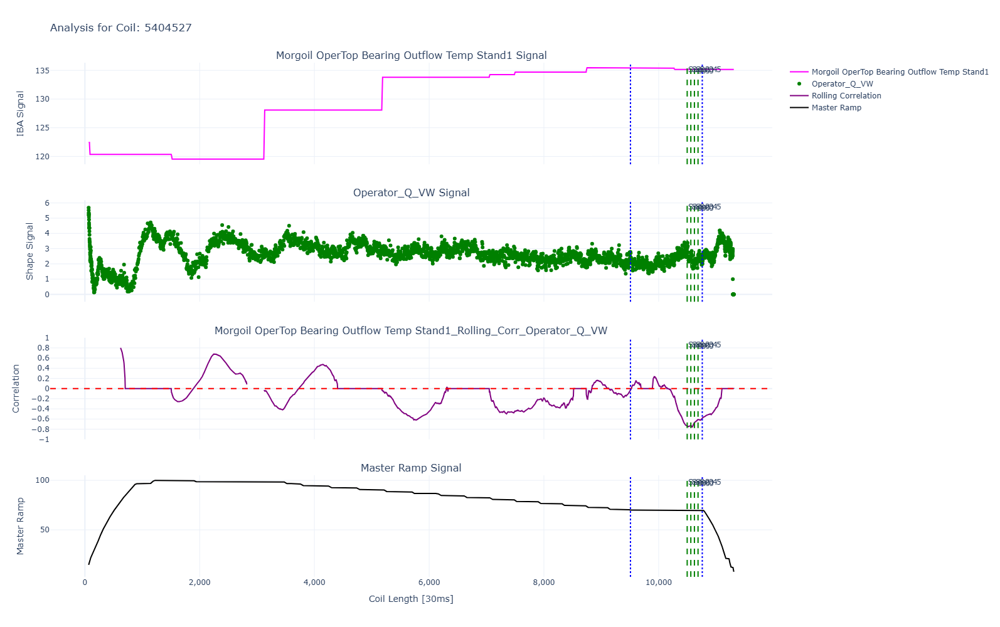


--- Coil ID: 5404584 ---
Phase 1: Total Windows = 12, Significant = 0
Phase 2: Total Windows = 1711, Significant = 104
Phase 3: Total Windows = 94, Significant = 0
  Segment 1: Total Windows = 342, Significant = 45
  Segment 2: Total Windows = 342, Significant = 59
  Segment 3: Total Windows = 342, Significant = 0
  Segment 4: Total Windows = 342, Significant = 0
  Segment 5: Total Windows = 343, Significant = 0


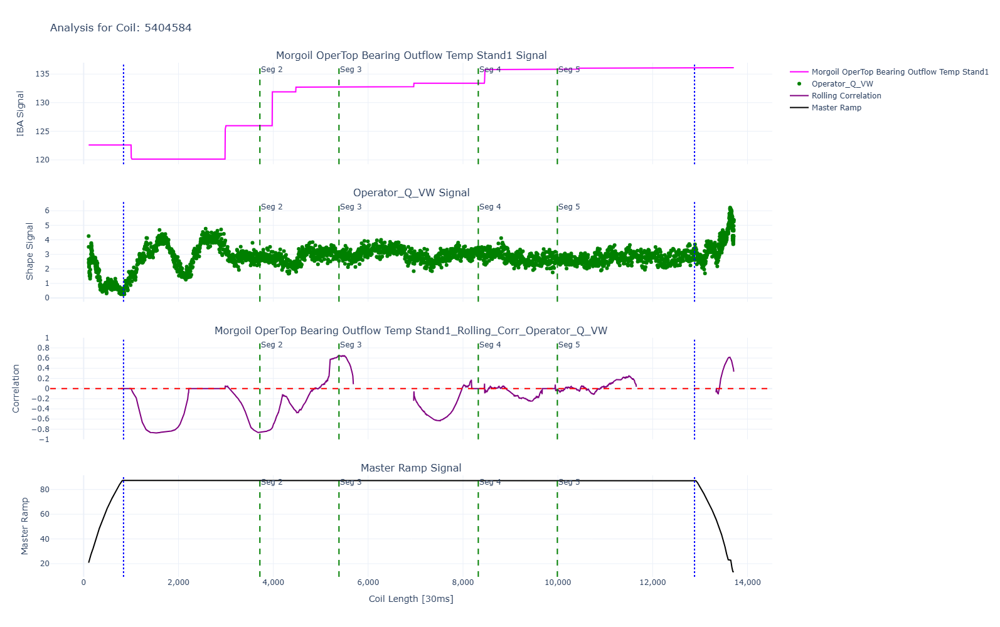


--- Coil ID: 5404715 ---
Phase 1: Total Windows = 66, Significant = 0
Phase 2: Total Windows = 358, Significant = 46
Phase 3: Total Windows = 1592, Significant = 0
  Segment 1: Total Windows = 71, Significant = 46
  Segment 2: Total Windows = 71, Significant = 0
  Segment 3: Total Windows = 71, Significant = 0
  Segment 4: Total Windows = 71, Significant = 0
  Segment 5: Total Windows = 74, Significant = 0


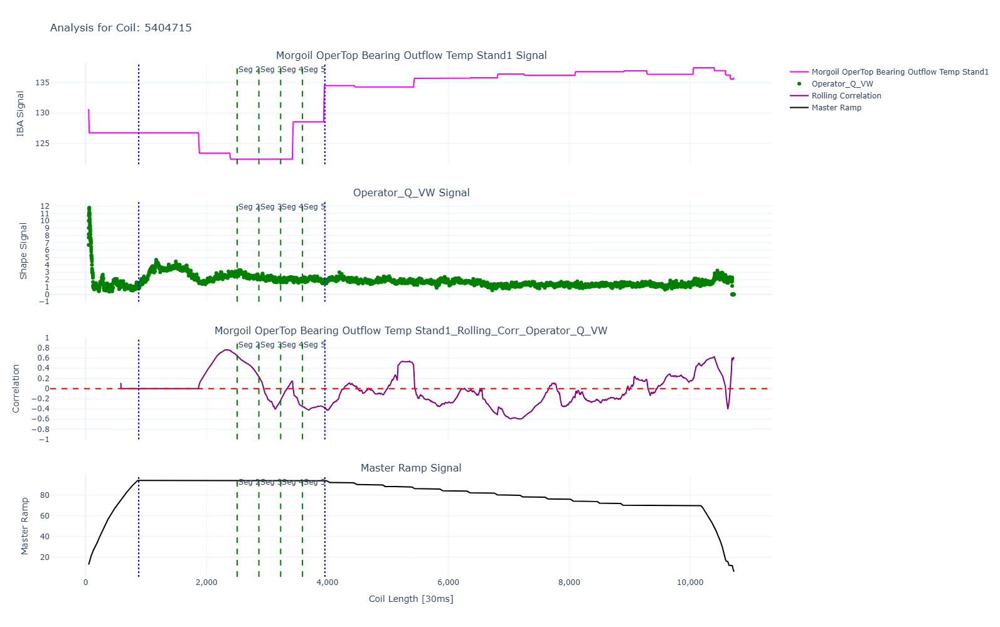


--- Coil ID: 5404741 ---
Phase 1: Total Windows = 78, Significant = 0
Phase 2: Total Windows = 728, Significant = 37
Phase 3: Total Windows = 1183, Significant = 0
  Segment 1: Total Windows = 145, Significant = 37
  Segment 2: Total Windows = 145, Significant = 0
  Segment 3: Total Windows = 145, Significant = 0
  Segment 4: Total Windows = 145, Significant = 0
  Segment 5: Total Windows = 148, Significant = 0


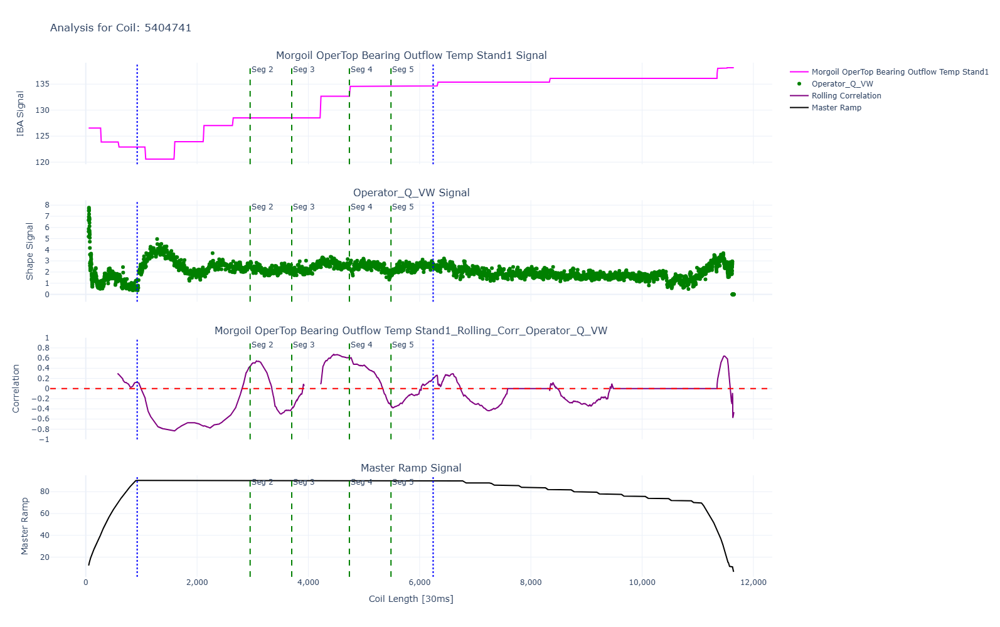


--- Coil ID: 5404753 ---
Phase 1: Total Windows = 76, Significant = 0
Phase 2: Total Windows = 838, Significant = 98
Phase 3: Total Windows = 1066, Significant = 71
  Segment 1: Total Windows = 167, Significant = 77
  Segment 2: Total Windows = 167, Significant = 21
  Segment 3: Total Windows = 167, Significant = 0
  Segment 4: Total Windows = 167, Significant = 0
  Segment 5: Total Windows = 170, Significant = 0


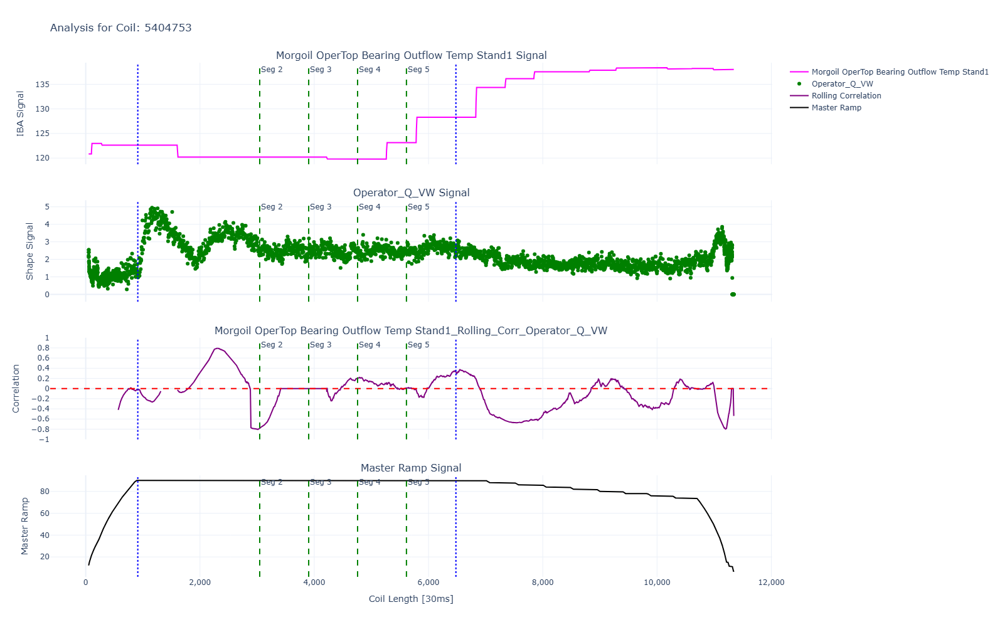


--- Coil ID: 5404763 ---
Phase 1: Total Windows = 70, Significant = 0
Phase 2: Total Windows = 956, Significant = 119
Phase 3: Total Windows = 650, Significant = 113
  Segment 1: Total Windows = 191, Significant = 6
  Segment 2: Total Windows = 191, Significant = 105
  Segment 3: Total Windows = 191, Significant = 0
  Segment 4: Total Windows = 191, Significant = 0
  Segment 5: Total Windows = 192, Significant = 8


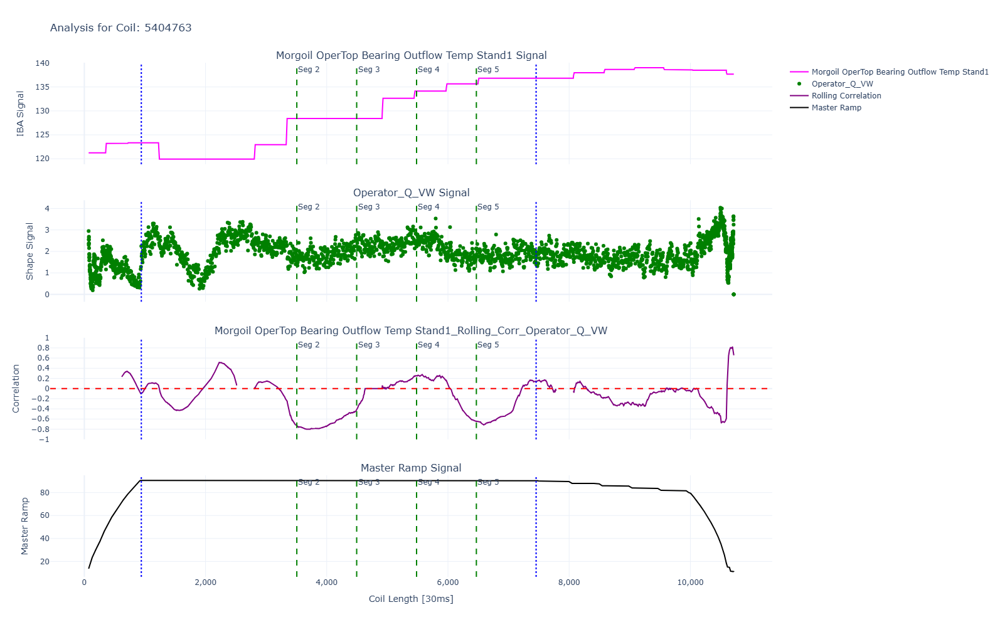


--- Coil ID: 5404771 ---
Phase 1: Total Windows = 72, Significant = 0
Phase 2: Total Windows = 747, Significant = 52
Phase 3: Total Windows = 1220, Significant = 39
  Segment 1: Total Windows = 149, Significant = 52
  Segment 2: Total Windows = 149, Significant = 0
  Segment 3: Total Windows = 149, Significant = 0
  Segment 4: Total Windows = 149, Significant = 0
  Segment 5: Total Windows = 151, Significant = 0


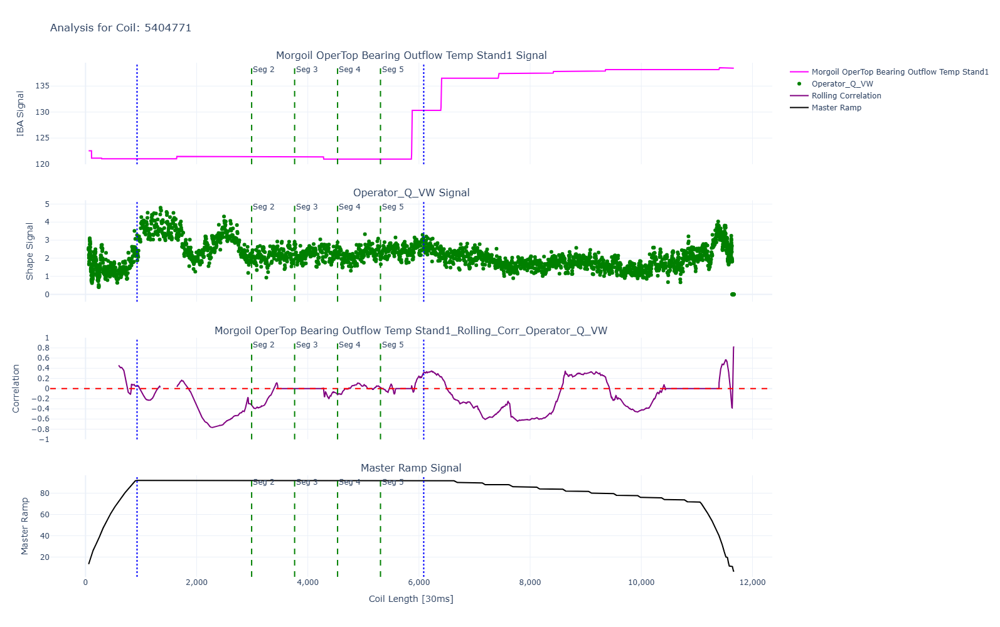


--- Coil ID: 5405070 ---
Phase 1: Total Windows = 40, Significant = 0
Phase 2: Total Windows = 1163, Significant = 173
Phase 3: Total Windows = 484, Significant = 125
  Segment 1: Total Windows = 232, Significant = 82
  Segment 2: Total Windows = 232, Significant = 0
  Segment 3: Total Windows = 232, Significant = 91
  Segment 4: Total Windows = 232, Significant = 0
  Segment 5: Total Windows = 235, Significant = 0


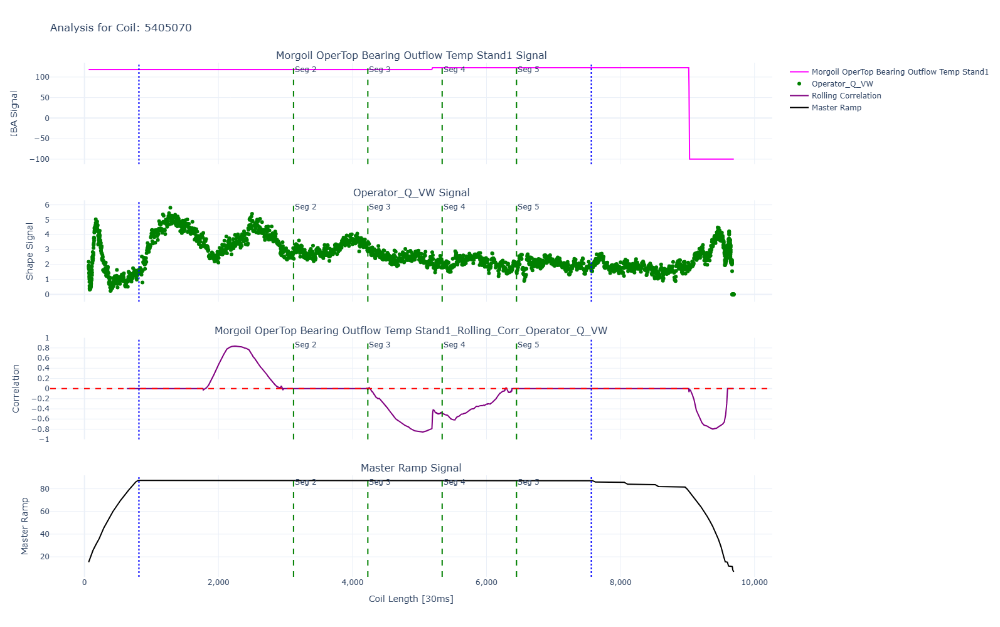


--- Coil ID: 5405968 ---
Phase 1: Total Windows = 337, Significant = 3
Phase 2: Total Windows = 4749, Significant = 464
Phase 3: Total Windows = 820, Significant = 0
  Segment 1: Total Windows = 949, Significant = 459
  Segment 2: Total Windows = 949, Significant = 0
  Segment 3: Total Windows = 949, Significant = 5
  Segment 4: Total Windows = 949, Significant = 0
  Segment 5: Total Windows = 953, Significant = 0



--- Coil ID: 5406182 ---
Phase 1: Total Windows = 1272, Significant = 0
Phase 2: Total Windows = 2994, Significant = 156
Phase 3: Total Windows = 1147, Significant = 30
  Segment 1: Total Windows = 598, Significant = 56
  Segment 2: Total Windows = 598, Significant = 100
  Segment 3: Total Windows = 598, Significant = 0
  Segment 4: Total Windows = 598, Significant = 0
  Segment 5: Total Windows = 602, Significant = 0



--- Coil ID: 5406353 ---
Phase 1: Total Windows = 59, Significant = 0
Phase 2: Total Windows = 564, Significant = 63
Phase 3: Total Windows = 1174, Significant = 0
  Segment 1: Total Windows = 112, Significant = 0
  Segment 2: Total Windows = 112, Significant = 0
  Segment 3: Total Windows = 112, Significant = 63
  Segment 4: Total Windows = 112, Significant = 0
  Segment 5: Total Windows = 116, Significant = 0



--- Coil ID: 5408994 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 1413, Significant = 73
Phase 3: Total Windows = 1213, Significant = 0
  Segment 1: Total Windows = 282, Significant = 0
  Segment 2: Total Windows = 282, Significant = 27
  Segment 3: Total Windows = 282, Significant = 46
  Segment 4: Total Windows = 282, Significant = 0
  Segment 5: Total Windows = 285, Significant = 0



--- Coil ID: 5415968 ---
Phase 1: Total Windows = 60, Significant = 0
Phase 2: Total Windows = 1814, Significant = 294
Phase 3: Total Windows = 528, Significant = 70
  Segment 1: Total Windows = 362, Significant = 80
  Segment 2: Total Windows = 362, Significant = 76
  Segment 3: Total Windows = 362, Significant = 89
  Segment 4: Total Windows = 362, Significant = 11
  Segment 5: Total Windows = 366, Significant = 38



--- Coil ID: 5416246 ---
Phase 1: Total Windows = 874, Significant = 61
Phase 2: Total Windows = 4677, Significant = 779
Phase 3: Total Windows = 974, Significant = 256
  Segment 1: Total Windows = 935, Significant = 221
  Segment 2: Total Windows = 935, Significant = 0
  Segment 3: Total Windows = 935, Significant = 177
  Segment 4: Total Windows = 935, Significant = 178
  Segment 5: Total Windows = 937, Significant = 203



--- Coil ID: 5416641 ---
Phase 1: Total Windows = 551, Significant = 0
Phase 2: Total Windows = 1351, Significant = 98
Phase 3: Total Windows = 489, Significant = 90
  Segment 1: Total Windows = 270, Significant = 0
  Segment 2: Total Windows = 270, Significant = 0
  Segment 3: Total Windows = 270, Significant = 0
  Segment 4: Total Windows = 270, Significant = 98
  Segment 5: Total Windows = 271, Significant = 0



--- Coil ID: 5416662 ---
Phase 1: Total Windows = 1, Significant = 0
Phase 2: Total Windows = 1487, Significant = 133
Phase 3: Total Windows = 457, Significant = 0
  Segment 1: Total Windows = 297, Significant = 39
  Segment 2: Total Windows = 297, Significant = 0
  Segment 3: Total Windows = 297, Significant = 0
  Segment 4: Total Windows = 297, Significant = 84
  Segment 5: Total Windows = 299, Significant = 10



--- Coil ID: 5416664 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 2602, Significant = 132
Phase 3: Total Windows = 538, Significant = 17
  Segment 1: Total Windows = 520, Significant = 0
  Segment 2: Total Windows = 520, Significant = 0
  Segment 3: Total Windows = 520, Significant = 132
  Segment 4: Total Windows = 520, Significant = 0
  Segment 5: Total Windows = 522, Significant = 0



--- Coil ID: 5442153 ---
Phase 1: Total Windows = 777, Significant = 51
Phase 2: Total Windows = 1264, Significant = 79
Phase 3: Total Windows = 739, Significant = 0
  Segment 1: Total Windows = 252, Significant = 0
  Segment 2: Total Windows = 252, Significant = 39
  Segment 3: Total Windows = 252, Significant = 40
  Segment 4: Total Windows = 252, Significant = 0
  Segment 5: Total Windows = 256, Significant = 0



--- Coil ID: 5419856 ---
Phase 1: Total Windows = 0, Significant = 0
Phase 2: Total Windows = 3726, Significant = 232
Phase 3: Total Windows = 512, Significant = 0
  Segment 1: Total Windows = 745, Significant = 15
  Segment 2: Total Windows = 745, Significant = 38
  Segment 3: Total Windows = 745, Significant = 83
  Segment 4: Total Windows = 745, Significant = 32
  Segment 5: Total Windows = 746, Significant = 64



✅ CSV saved as Phase_Segment_Correlation_Stats.csv


In [6]:
import pandas as pd
import os
import plotly.graph_objects as go
from plotly.subplots import make_subplots

results = []  # To collect data for CSV

def analyze_and_plot_phases(
    df, coil_id, continuous_col, discrete_col, corr_col,
    coil_length_col, ramp_col="Master Ramp", correlation_threshold=0.7,
    coil_type=None, grade=None
):
    coil_length_values = df[coil_length_col]
    window_size = 250

    if df[ramp_col].max() <= 15:
        print(f"[{coil_id}] Low Master Ramp")
        return

    # Determine phase boundaries using mode of ramp signal
    norm_val = df[ramp_col].mode()[0]
    norm_df = df[df[ramp_col] == norm_val]
    phase1_end = norm_df.index[0]
    phase2_end = norm_df.index[-1]

    phase1_df = df.iloc[:phase1_end + 1]
    phase2_df = df.iloc[phase1_end:phase2_end + 1]
    phase3_df = df.iloc[phase2_end + 1:]

    def get_correlation_stats(data):
        corr_series = data[corr_col].iloc[window_size:].dropna()
        total = len(corr_series)
        significant = (corr_series.abs() >= correlation_threshold).sum()
        return total, significant

    # Phase-wise stats
    print(f"\n--- Coil ID: {coil_id} ---")
    phase1_total, phase1_significant = get_correlation_stats(phase1_df)
    phase2_total, phase2_significant = get_correlation_stats(phase2_df)
    phase3_total, phase3_significant = get_correlation_stats(phase3_df)

    print(f"Phase 1: Total Windows = {phase1_total}, Significant = {phase1_significant}")
    print(f"Phase 2: Total Windows = {phase2_total}, Significant = {phase2_significant}")
    print(f"Phase 3: Total Windows = {phase3_total}, Significant = {phase3_significant}")

    # Store phase-wise
    results.extend([
        {
            "Coil ID": coil_id, "Coil Type": coil_type, "Grade": grade,
            "Phase": "Phase 1", "Segment": "-",
            "Total Windows": phase1_total,
            "Significant Windows": phase1_significant,
            "Contribution %": round((phase1_significant / phase1_total) * 100, 2) if phase1_total else 0
        },
        {
            "Coil ID": coil_id, "Coil Type": coil_type, "Grade": grade,
            "Phase": "Phase 2", "Segment": "-",
            "Total Windows": phase2_total,
            "Significant Windows": phase2_significant,
            "Contribution %": round((phase2_significant / phase2_total) * 100, 2) if phase2_total else 0
        },
        {
            "Coil ID": coil_id, "Coil Type": coil_type, "Grade": grade,
            "Phase": "Phase 3", "Segment": "-",
            "Total Windows": phase3_total,
            "Significant Windows": phase3_significant,
            "Contribution %": round((phase3_significant / phase3_total) * 100, 2) if phase3_total else 0
        }
    ])

    # Segment Phase 2
    phase2_corr_series = df.loc[phase2_df.index, corr_col].iloc[window_size:].dropna()
    valid_phase2_indices = phase2_corr_series.index
    valid_phase2_df = df.loc[valid_phase2_indices]

    seg_size = len(valid_phase2_df) // 5
    segment_indices = []

    segment_totals = 0
    segment_significants = 0

    for i in range(5):
        start = i * seg_size
        end = (i + 1) * seg_size if i < 4 else len(valid_phase2_df)
        segment = valid_phase2_df.iloc[start:end]
        segment_corr = phase2_corr_series[segment.index]

        total = len(segment_corr)
        significant = (segment_corr.abs() >= correlation_threshold).sum()

        segment_totals += total
        segment_significants += significant

        print(f"  Segment {i+1}: Total Windows = {total}, Significant = {significant}")

        results.append({
            "Coil ID": coil_id, "Coil Type": coil_type, "Grade": grade,
            "Phase": "Phase 2", "Segment": f"Segment {i+1}",
            "Total Windows": total,
            "Significant Windows": significant,
            "Contribution %": round((significant / total) * 100, 2) if total else 0
        })

        segment_indices.append(segment.index[0])

    assert segment_totals == phase2_total, "Segment total windows do not match Phase 2"
    assert segment_significants == phase2_significant, "Segment significant counts do not match Phase 2"

    # Plotting
    fig = make_subplots(
        rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.07,
        subplot_titles=[
            f"{continuous_col} Signal",
            f"{discrete_col} Signal",
            f"{corr_col}",
            f"{ramp_col} Signal"
        ]
    )

    fig.add_trace(go.Scatter(x=coil_length_values, y=df[continuous_col], mode="lines", name=continuous_col,
                             line=dict(color="magenta")), row=1, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[discrete_col], mode="markers", name=discrete_col,
                             marker=dict(color="green", size=6)), row=2, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[corr_col], mode="lines", name="Rolling Correlation",
                             line=dict(color="purple")), row=3, col=1)
    fig.add_trace(go.Scatter(x=coil_length_values, y=df[ramp_col], mode="lines", name=ramp_col,
                             line=dict(color="black")), row=4, col=1)

    fig.add_hline(y=0, line=dict(color="red", dash="dash"), row=3, col=1)

    x1 = df[coil_length_col].iloc[phase1_end]
    x2 = df[coil_length_col].iloc[phase2_end]
    for row in [1, 2, 3, 4]:
        fig.add_vline(x=x1, line=dict(color="blue", dash="dot"), row=row, col=1)
        fig.add_vline(x=x2, line=dict(color="blue", dash="dot"), row=row, col=1)

    for i, seg_idx in enumerate(segment_indices[1:], start=2):
        x = df[coil_length_col].loc[seg_idx]
        for row in [1, 2, 3, 4]:
            fig.add_vline(x=x, line=dict(color="green", dash="dash"),
                          row=row, col=1,
                          annotation_text=f"Seg {i}", annotation_position="top right")

    fig.update_yaxes(title_text="IBA Signal", row=1, col=1)
    fig.update_yaxes(title_text="Shape Signal", dtick=1, row=2, col=1)
    fig.update_yaxes(title_text="Correlation", range=[-1, 1], dtick=0.2, row=3, col=1)
    fig.update_yaxes(title_text="Master Ramp", row=4, col=1)

    fig.update_xaxes(tickformat=",.0f", row=4, col=1)
    fig.update_layout(
        title_text=f"Analysis for Coil: {coil_id}",
        height=1000,
        xaxis4=dict(title=coil_length_col),
        template="plotly_white",
        showlegend=True
    )

    fig.show()


# ----------------------
# Load Metadata and Process All Coils
# ----------------------

metadata_df = pd.read_excel("Filtered Coils for investigation.xlsx", sheet_name="Sheet2")

for _, row in metadata_df.iterrows():
    coil_id = str(row["Coil ID"])
    coil_type = row["Coil Type"]
    grade = row["Grade"]

    csv_path = os.path.join(f"{coil_type} {grade}", "Whole_Phase_intercorrelation", f"{coil_id}.csv")
    if not os.path.exists(csv_path):
        print(f"File not found: {csv_path}")
        continue

    try:
        df = pd.read_csv(csv_path)
        analyze_and_plot_phases(
            df,
            coil_id=coil_id,
            continuous_col="Morgoil OperTop Bearing Outflow Temp Stand1",
            discrete_col="Operator_Q_VW",
            corr_col="Morgoil OperTop Bearing Outflow Temp Stand1_Rolling_Corr_Operator_Q_VW",
            coil_length_col="Coil Length [30ms]",
            ramp_col="Master Ramp",
            coil_type=coil_type,
            grade=grade
        )
    except Exception as e:
        print(f"Error processing {coil_id}: {e}")

# ----------------------
# Save to CSV
# ----------------------

results_df = pd.DataFrame(results)
results_df.to_csv("Phase_Segment_Correlation_Stats.csv", index=False)
print("\n✅ CSV saved as Phase_Segment_Correlation_Stats.csv")


In [11]:
import pandas as pd

# Load the data
df = pd.read_csv("Phase_Segment_Correlation_Stats.csv")

# Filter only Phase 2 segments (excluding rows like "Phase 1" or unsegmented "Phase 2")
segment_df = df[(df["Phase"] == "Phase 2") & (df["Segment"] != "-")]

# Compute average and median contribution % per segment
segment_summary = segment_df.groupby("Segment")["Contribution %"].agg(["mean", "median"]).reset_index()
segment_summary.columns = ["Segment", "Average Contribution %", "Median Contribution %"]
display(segment_summary)

# Identify the top contributing segment per coil
top_segment_per_coil = (
    segment_df.loc[segment_df.groupby("Coil ID")["Contribution %"].idxmax()]
    .groupby("Segment")["Coil ID"]
    .count()
    .reset_index()
    .rename(columns={"Coil ID": "Times Highest Contributor"})
)

# Merge the metrics together
segment_rank_summary = pd.merge(segment_summary, top_segment_per_coil, on="Segment")

# Sort by average contribution percentage (descending)
segment_rank_summary = segment_rank_summary.sort_values(by="Average Contribution %", ascending=False)

# Display the summary
display(segment_rank_summary[["Segment", "Times Highest Contributor"]])


,Segment,Average Contribution %,Median Contribution %
0,Segment 1,18.557500,13.820
1,Segment 2,12.150000,4.455
2,Segment 3,10.840000,0.000
3,Segment 4,5.160000,0.000
4,Segment 5,1.721944,0.000


,Segment,Times Highest Contributor
0,Segment 1,15
1,Segment 2,8
2,Segment 3,9
3,Segment 4,4


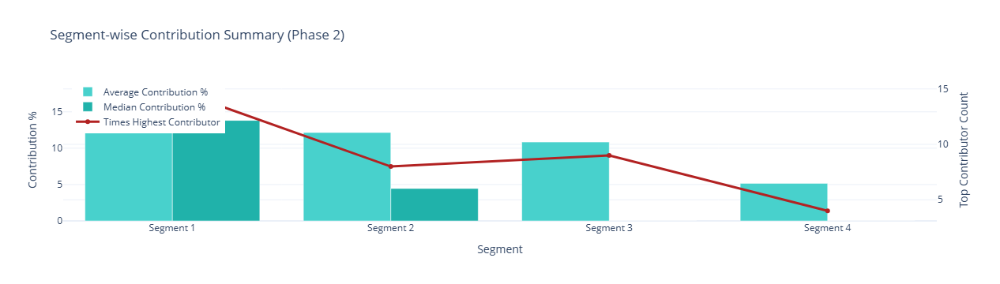

In [6]:
import pandas as pd
import plotly.graph_objects as go

# Load data
df = pd.read_csv("Phase_Segment_Correlation_Stats.csv")

# Filter Phase 2 segments only
segment_df = df[(df["Phase"] == "Phase 2") & (df["Segment"] != "-")]

# Summary: mean and median contribution %
segment_summary = segment_df.groupby("Segment")["Contribution %"].agg(["mean", "median"]).reset_index()
segment_summary.columns = ["Segment", "Average Contribution %", "Median Contribution %"]

# Count top contributor frequency
top_segment_per_coil = (
    segment_df.loc[segment_df.groupby("Coil ID")["Contribution %"].idxmax()]
    .groupby("Segment")["Coil ID"]
    .count()
    .reset_index()
    .rename(columns={"Coil ID": "Times Highest Contributor"})
)

# Merge all metrics
segment_rank_summary = pd.merge(segment_summary, top_segment_per_coil, on="Segment")
segment_rank_summary = segment_rank_summary.sort_values(by="Average Contribution %", ascending=False)

# Plotting
fig = go.Figure()

# Average Contribution
fig.add_trace(go.Bar(
    x=segment_rank_summary["Segment"],
    y=segment_rank_summary["Average Contribution %"],
    name="Average Contribution %",
    marker_color='mediumturquoise'
))

# Median Contribution
fig.add_trace(go.Bar(
    x=segment_rank_summary["Segment"],
    y=segment_rank_summary["Median Contribution %"],
    name="Median Contribution %",
    marker_color='lightseagreen'
))

# Times Highest Contributor (as line overlaid)
fig.add_trace(go.Scatter(
    x=segment_rank_summary["Segment"],
    y=segment_rank_summary["Times Highest Contributor"],
    name="Times Highest Contributor",
    mode="lines+markers",
    line=dict(color="firebrick", width=3),
    yaxis="y2"
))

# Layout
fig.update_layout(
    title="Segment-wise Contribution Summary (Phase 2)",
    xaxis_title="Segment",
    yaxis=dict(title="Contribution %"),
    yaxis2=dict(
        title="Top Contributor Count",
        overlaying="y",
        side="right"
    ),
    barmode='group',
    template='plotly_white',
    legend=dict(x=0.01, y=0.99)
)

fig.show()
